In [2]:
import numpy as np
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import pandas as pd
import scipy.stats as stats
import seaborn as sn
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import plotly 
import plotly.express as px
import plotly.graph_objs as go
import requests
import datetime
from dateutil.parser import parse
import logging
import json
import spotipy
import time
from spotipy.oauth2 import SpotifyClientCredentials
import csv
import json
import requests
from wordcloud import WordCloud
import seaborn

%matplotlib inline
pd.options.display.max_rows = 10000

In [426]:
# Read streaming history, library and extended history

# Streaming history
df_stream = pd.read_json("data/StreamingHistory0.json")
df_stream['Song'] = df_stream['trackName'] + " (" + df_stream['artistName'] + ")" 
df_stream.head()

# Library
df_library = pd.read_json("data/YourLibrary.json")


# Combine all extended history in a dataframe
# Relevant fields: platform, ms_played, master_metadata_track_name, 
# master_metadata_album_artist_name, spotify_track_uri, reason_start
df_extended1 = pd.read_json('data/endsong_0.json')
df_extended2 = pd.read_json('data/endsong_1.json')
df_extended3 = pd.read_json('data/endsong_2.json')
df_extended = pd.concat([df_extended1, df_extended2, df_extended3])
df_extended = df_extended[['platform', 'ms_played', 'ts', 'master_metadata_track_name', 'master_metadata_album_artist_name', 'spotify_track_uri', 'reason_start']]
df_extended

,platform,ms_played,ts,master_metadata_track_name,master_metadata_album_artist_name,spotify_track_uri,reason_start
0,Partner google cast_voice;Google_Home;;2.0.0-6...,213730,2019-08-04T09:50:34Z,Tu Manera de Querer,Carla Morrison,spotify:track:5TWaxDNpgx1xnNIjrUQo5P,trackdone
1,OS X 10.14.6 [x86 8],260620,2019-10-22T07:58:57Z,Why Am I the One,fun.,spotify:track:5QbQ5iAebksB5Wj5BPazNX,appload
2,"Android OS 11 API 30 (Google, Pixel 4)",7495,2021-07-20T18:07:03Z,nana triste,Natalia Lacunza,spotify:track:721Lxh9pNJJhNERON4Zjmw,fwdbtn
3,OS X 12.5.1 [x86 8],17008,2022-09-08T15:22:57Z,Nada que perder,Pignoise,spotify:track:0YSaKC66FGCWLxM9SoQA1f,clickrow
4,Partner google cast_voice;Google_Home;;5.10.0-...,253014,2022-03-11T22:41:07Z,Youth,Daughter,spotify:track:2Ck6gblyk3UFCVPTh8o3TN,trackdone
...,...,...,...,...,...,...,...
4018,"Android OS 12 API 32 (Google, Pixel 4)",127550,2022-03-26T21:51:24Z,Segundo movimiento: Mierda de filosofía,Robe,spotify:track:63Zg2q0NxOIoVu7olYHl9t,clickrow
4019,Partner google cast;Google_Home;;2.0.0-357-22b...,68447,2018-04-18T18:38:00Z,"Soy Marco (From ""Talk to Her (Hable Con Ella)"")",Alberto Iglesias,spotify:track:11pgYPpViYqlp9vxLqaaHr,clickrow
4020,"Android OS 8.1.0 API 27 (LGE, Nexus 5X)",1310,2019-02-16T13:14:43Z,No Hay Tanto Pan,Sílvia Pérez Cruz,spotify:track:6JpnuuUfAoQX5H2a9xlGjW,fwdbtn
4021,"Android OS 8.1.0 API 27 (LGE, Nexus 5X)",286078,2019-02-04T10:15:45Z,Humo (Acústico),Travis Birds,spotify:track:44kcjkti0jeopOjx04mbRx,trackdone


In [420]:
# Utils 
def convert_timedelta(duration):
    days, seconds = duration.days, duration.seconds
    hours = days * 24 + seconds // 3600
    minutes = (seconds % 3600) // 60
    seconds = (seconds % 60)
    return hours, minutes, seconds

def convert_timedelta_minutes(duration):
    days, seconds = duration.days, duration.seconds
    hours = days * 24 + seconds // 3600
    minutes = hours * 60 + (seconds % 3600) // 60
    return minutes

In [421]:
# Time listened per day over time in minutes
df_time=df_stream.copy()
df_time['Day']=df_time['endTime'].str[0:10]

df_time=df_time[['Day', 'msPlayed']]\
    .groupby('Day')\
    .sum()\
    .sort_values('msPlayed', ascending=False)\
    .reset_index()

for i, row in df_time.iterrows():
    time = datetime.timedelta(milliseconds=float(df_time.at[i,'msPlayed']))
    minutes = convert_timedelta_minutes(time)
    df_time.at[i,'Time']= minutes

df_time = df_time[['Day', 'Time']]\
    .groupby('Day')\
    .sum()\
    .sort_values('Day', ascending=True)\
    .reset_index()

df_time

,Day,Time
0,2021-10-04,26.0
1,2021-10-06,28.0
2,2021-10-07,110.0
3,2021-10-09,32.0
4,2021-10-10,11.0
5,2021-10-17,61.0
6,2021-10-19,20.0
7,2021-10-20,28.0
8,2021-10-21,21.0
9,2021-10-22,59.0


In [422]:
# Time listened per month over time
df_time['date'] = [parse(date).date() for date in df_time['Day']]
df_time['Month'] = pd.to_datetime(df_time['date']).dt.to_period('M')

df_month = df_time[['Month', 'Time']]\
    .groupby('Month')\
    .sum()\
    .sort_values('Month', ascending=True)\
    .reset_index()
df_month['Time'] = round(df_month['Time'].apply(lambda x: x/60))

df_time

,Day,Time,date,Month
0,2021-10-04,26.0,2021-10-04,2021-10
1,2021-10-06,28.0,2021-10-06,2021-10
2,2021-10-07,110.0,2021-10-07,2021-10
3,2021-10-09,32.0,2021-10-09,2021-10
4,2021-10-10,11.0,2021-10-10,2021-10
5,2021-10-17,61.0,2021-10-17,2021-10
6,2021-10-19,20.0,2021-10-19,2021-10
7,2021-10-20,28.0,2021-10-20,2021-10
8,2021-10-21,21.0,2021-10-21,2021-10
9,2021-10-22,59.0,2021-10-22,2021-10


In [423]:
# Line chart of minutes listened to music per day
fig = go.Figure(data=go.Scatter(x=df_time['Day'].astype(dtype=str), 
                                y=df_time['Time'],
                                marker_color='indianred', text="Minutes"))
fig.update_layout({"title": 'Minutes listened to music per day',
                   "xaxis": {"title":"Day"},
                   "yaxis": {"title":"Total minutes"}})
fig.update_traces(mode="lines", hovertemplate=None)
fig.update_layout(hovermode="x")
fig.show()


# Line chart of minutes listened to music per month
fig = go.Figure(data=go.Scatter(x=df_month['Month'].astype(dtype=str), 
                                y=df_month['Time'],
                                marker_color='green', text="Hours"))
fig.update_layout({"title": 'Hours listened to music per month',
                   "xaxis": {"title":"Month"},
                   "yaxis": {"title":"Total Hours"}})
fig.update_traces(mode="markers+lines", hovertemplate=None)
fig.update_layout(hovermode="x")
fig.show()

In [424]:
# Heat map of hours listened to music per month
fig = px.density_heatmap(df_month, x=df_time['Day'].astype(dtype=str), 
                                y=df_time['Time'])
fig.update_layout({"title": 'Hours listened to music per month',
                   "xaxis": {"title":"Month"},
                   "yaxis": {"title":"Total Hours"}})
fig.show()

In [7]:
# Time listened by hour over time
df_time=df_stream.copy()

for i, row in df_time.iterrows():
    time = datetime.timedelta(milliseconds=float(df_time.at[i,'msPlayed']))
    minutes = convert_timedelta_minutes(time)
    df_time.at[i,'Time']= minutes

df_hour=df_time.copy()
df_hour['Hour']=df_time['endTime'].str[11:13]

df_hour = df_hour.sort_values(by=['Hour'],ascending=True)
df_hour

,endTime,artistName,trackName,msPlayed,UniqueID,Song,Time,Hour
2588,2022-03-12 00:19,Daft Punk,One More Time,23,Daft Punk:One More Time,One More Time (Daft Punk),0.0,00
1800,2022-02-18 00:41,Sammy Davis Jr.,Something's Gotta Give,545,Sammy Davis Jr.:Something's Gotta Give,Something's Gotta Give (Sammy Davis Jr.),0.0,00
1799,2022-02-18 00:41,Sammy Davis Jr.,Something's Gotta Give,233,Sammy Davis Jr.:Something's Gotta Give,Something's Gotta Give (Sammy Davis Jr.),0.0,00
1798,2022-02-18 00:41,Orchestre de la Paillote,Kadia Blues,2313,Orchestre de la Paillote:Kadia Blues,Kadia Blues (Orchestre de la Paillote),0.0,00
1797,2022-02-18 00:41,Orchestre de la Paillote,Kadia Blues,570,Orchestre de la Paillote:Kadia Blues,Kadia Blues (Orchestre de la Paillote),0.0,00
1796,2022-02-18 00:41,Sunlightsquare,Super People,3261,Sunlightsquare:Super People,Super People (Sunlightsquare),0.0,00
1795,2022-02-18 00:41,Sunlightsquare,Super People,256,Sunlightsquare:Super People,Super People (Sunlightsquare),0.0,00
1794,2022-02-18 00:41,Fred Astaire,The Carioca,107532,Fred Astaire:The Carioca,The Carioca (Fred Astaire),1.0,00
1801,2022-02-18 00:41,Ruben Gonzalez,Cumbanchero,577,Ruben Gonzalez:Cumbanchero,Cumbanchero (Ruben Gonzalez),0.0,00
1793,2022-02-18 00:39,Lee Morgan,Sweet Honey Bee,410259,Lee Morgan:Sweet Honey Bee,Sweet Honey Bee (Lee Morgan),6.0,00


In [8]:
# Heat map of music listened by hour of day over time
fig = px.density_heatmap(df_month, x=df_hour['Hour'].astype(dtype=str), 
                                y=df_hour['Time'])
fig.update_layout({"title": 'Music listened by hour of day',
                   "xaxis": {"title":"Hour"},
                   "yaxis": {"title":"Song duration"}})
fig.update(layout_yaxis_range = [0,4])
fig.show()

In [9]:
# Time listened by hour of day over time
df_time=df_stream.copy()
df_time['Day']=df_time['endTime'].str[11:13]

df_time=df_time[['Day', 'msPlayed']]\
    .groupby('Day')\
    .count()\
    .sort_values('msPlayed', ascending=False)\
    .reset_index()

df_time.columns = ['Time of Day', 'Count']

In [10]:
# Bar chart of songs listened by hour of day
df_time = df_time.sort_values(by=['Time of Day'],ascending=True)
fig = px.bar(df_time, x=df_time['Time of Day'].astype(dtype=str), 
                                y=df_time['Count'])
fig.update_layout({"title": 'Number of songs listened by the time of the day in 2022',
                   "xaxis": {"title":"Time of Day"},
                   "yaxis": {"title":"Number of songs listened"}})
fig.show()

In [393]:
# Minutes listened and song count per artist (Top 100)
df_numbercharted=df_stream[['artistName', 'msPlayed']]\
    .groupby('artistName')\
    ['msPlayed'].agg(msPlayed='sum', Count='count')\
    .sort_values('msPlayed', ascending=False)\
    .reset_index()
df_numbercharted.columns = ['Artist', 'msPlayed', 'Songs count']

for i, row in df_numbercharted.iterrows():
    time = datetime.timedelta(milliseconds=float(df_numbercharted.at[i,'msPlayed']))
    hours, minutes, seconds = convert_timedelta(time)
    df_numbercharted.at[i,'Time']= '{} hours, {} minutes'.format(hours, minutes)

df_numbercharted = df_numbercharted[['Artist', 'Time', 'Songs count']]
df_numbercharted = df_numbercharted[df_numbercharted['Artist']!='Unknown Artist']
df_numbercharted.head(100)

,Artist,Time,Songs count
0,Nadie Sabe Nada,"50 hours, 12 minutes",113
1,ROSALÍA,"15 hours, 1 minutes",401
2,XRey,"9 hours, 0 minutes",33
3,Robe,"8 hours, 59 minutes",102
4,C. Tangana,"7 hours, 46 minutes",216
5,Extremoduro,"7 hours, 22 minutes",176
7,Zahara,"4 hours, 58 minutes",120
8,Ultimo,"4 hours, 23 minutes",90
9,Maria Arnal i Marcel Bagés,"3 hours, 38 minutes",95
10,Estopa,"3 hours, 23 minutes",87


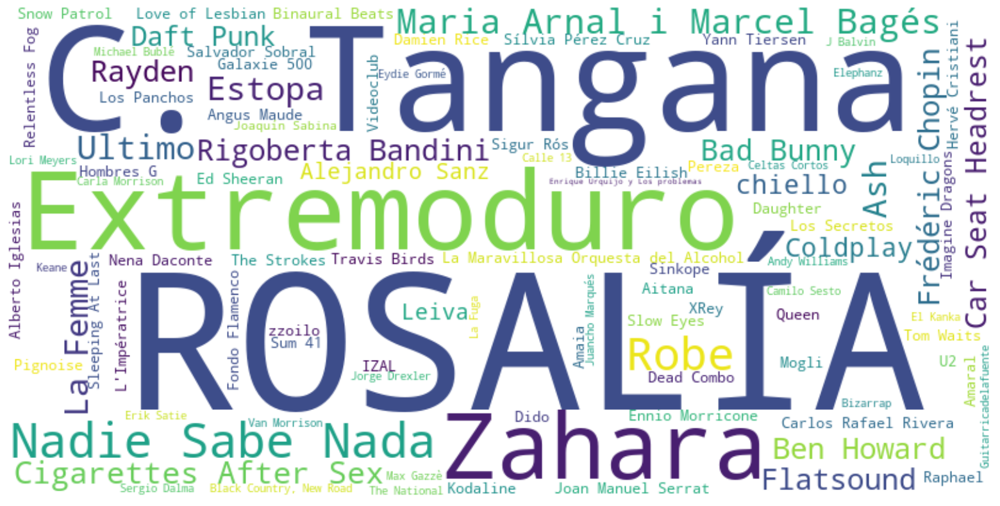

In [394]:
# converted df to dict
artist_freq = dict(zip(df_numbercharted['Artist'].tolist(), df_numbercharted['Songs count'].tolist()))

# plot wordcloud
wc = WordCloud(background_color='white',width=800, height=400, max_words=200).generate_from_frequencies(artist_freq)
plt.figure(figsize=(20, 10))
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.show()

In [12]:
# Draw bar chart of time played per artist (Top 25)
df_numbercharted = df_stream[['artistName', 'msPlayed']]\
    .groupby('artistName')\
    ['msPlayed'].agg(msPlayed='sum', Count='count')\
    .sort_values('msPlayed', ascending=False)\
    .reset_index().head(25)
df_numbercharted.columns = ['Artist', 'msPlayed', 'Songs count']

for i, row in df_numbercharted.iterrows():
    time = datetime.timedelta(milliseconds=float(df_numbercharted.at[i,'msPlayed']))
    hours, minutes, seconds = convert_timedelta(time)
    df_numbercharted.at[i,'Time']= hours
df_numbercharted = df_numbercharted[~df_numbercharted['Artist'].str.contains("Unknown Artist")]
df_numbercharted = df_numbercharted[~df_numbercharted['Artist'].str.contains("Nadie Sabe Nada")]
df_numbercharted = df_numbercharted[~df_numbercharted['Artist'].str.contains("XRey")]

fig = px.bar(data_frame=df_numbercharted[['Artist', 'Time']],x='Artist', y='Time', 
             height=600, width=800,
             color='Time',
             title="Top 25 Artists with Highest Amount of Time Played",
             labels={'Artist': 'Artist', 'Time': 'Time Played (Hours)'})
fig.update_layout(barmode='group', xaxis_tickangle=-45)
fig.show()

In [13]:
# Minutes listened and song count per song (Top 100) ordered by time played
df_numbercharted_song=df_stream[['Song', 'msPlayed']]\
    .groupby('Song')\
    ['msPlayed'].agg(msPlayed='sum', Count='count')\
    .sort_values('msPlayed', ascending=False)\
    .reset_index()
df_numbercharted_song.columns = ['Song', 'msPlayed', 'Times played']

for i, row in df_numbercharted_song.iterrows():
    time = datetime.timedelta(milliseconds=float(df_numbercharted_song.at[i,'msPlayed']))
    hours, minutes, seconds = convert_timedelta(time)
    df_numbercharted_song.at[i,'Time']= '{} hours, {} minutes'.format(hours, minutes)

df_numbercharted_song = df_numbercharted_song[['Song', 'Time', 'Times played']]
df_numbercharted_song = df_numbercharted_song[df_numbercharted_song['Song']!='Unknown Track (Unknown Artist)']
df_numbercharted_song = df_numbercharted_song[~df_numbercharted_song['Song'].str.contains("Nadie Sabe Nada")]
df_numbercharted_song = df_numbercharted_song[~df_numbercharted_song['Song'].str.contains("XRey")]
df_numbercharted_song[~df_numbercharted_song['Song'].str.contains("Reinas de España")].head(100)

,Song,Time,Times played
1,Tercer movimiento: Un instante de luz (Robe),"3 hours, 48 minutes",30
2,COMO UN G (ROSALÍA),"3 hours, 17 minutes",58
3,Sober to Death (Car Seat Headrest),"2 hours, 18 minutes",36
4,Instant Crush (feat. Julian Casablancas) (Daft...,"2 hours, 10 minutes",35
7,Si te vas... (Extremoduro),"1 hours, 44 minutes",31
8,Segundo movimiento: lo de fuera (Extremoduro),"1 hours, 39 minutes",14
9,Cuarto movimiento: Yo no soy el dueño de mis e...,"1 hours, 34 minutes",15
11,Un Suspiro Acompasado (Robe),"1 hours, 29 minutes",14
12,Depth Over Distance (Ben Howard),"1 hours, 28 minutes",23
13,Tú Que Vienes a Rondarme (Maria Arnal i Marcel...,"1 hours, 28 minutes",34


In [14]:
# Minutes listened and song count per song (Top 100) ordered by play count
df_numbercharted_song.sort_values('Times played', ascending=False).reset_index().head(100)

,index,Song,Time,Times played
0,2,COMO UN G (ROSALÍA),"3 hours, 17 minutes",58
1,3,Sober to Death (Car Seat Headrest),"2 hours, 18 minutes",36
2,4,Instant Crush (feat. Julian Casablancas) (Daft...,"2 hours, 10 minutes",35
3,19,Demasiadas Mujeres (C. Tangana),"1 hours, 15 minutes",34
4,13,Tú Que Vienes a Rondarme (Maria Arnal i Marcel...,"1 hours, 28 minutes",34
5,16,HENTAI (ROSALÍA),"1 hours, 20 minutes",34
6,15,CANDY (ROSALÍA),"1 hours, 20 minutes",33
7,7,Si te vas... (Extremoduro),"1 hours, 44 minutes",31
8,18,Mon Amour - Remix (zzoilo),"1 hours, 18 minutes",31
9,1,Tercer movimiento: Un instante de luz (Robe),"3 hours, 48 minutes",30


In [15]:
# Draw bar chart of Top 200 Songs with Highest Amount of Times Played
df_numbercharted = df_stream[['Song', 'msPlayed']]\
    .groupby('Song')\
    .count()\
    .sort_values('msPlayed', ascending=False)\
    .reset_index().head(200)
df_numbercharted.columns = ['Song', 'Times Played']

df_numbercharted=df_numbercharted.sort_values('Times Played', ascending=False)
df_numbercharted = df_numbercharted[~df_numbercharted['Song'].str.contains("Unknown Artist")]
df_numbercharted = df_numbercharted[~df_numbercharted['Song'].str.contains("Nadie Sabe Nada")]
df_numbercharted = df_numbercharted[~df_numbercharted['Song'].str.contains("XRey")]

fig = px.bar(data_frame=df_numbercharted,x='Song', y='Times Played',  
             height=600, width=800,
             color='Times Played',
             title="Top 200 Songs with Highest Amount of Times Played",
             labels={'Song':'Songs'})
fig.update_xaxes(visible=True, showticklabels=False)
fig.show()

In [20]:
# Songs listened to vs songs in my library over time  
# add columns checking if streamed song is in library
df_in_library = df_stream.copy()
df_in_library['In Library'] = np.where(df_in_library['trackName'].isin(df_library['track'].tolist()),1,0)
df_in_library['Not In Library'] = np.where(~df_in_library['trackName'].isin(df_library['track'].tolist()),1,0)
df_in_library['Total']=df_in_library['In Library']+df_in_library['Not In Library']
df_in_library['Day']=df_stream['endTime'].str[0:10]

df_in_library=df_in_library\
    .groupby('Day')\
    .sum(numeric_only=False)\
    .reset_index()
df_in_library[['Day', 'In Library', 'Not In Library', 'Total']]

,Day,In Library,Not In Library,Total
0,2021-10-04,0,1,1
1,2021-10-06,0,10,10
2,2021-10-07,1,18,19
3,2021-10-09,4,6,10
4,2021-10-10,1,3,4
5,2021-10-17,14,2,16
6,2021-10-19,4,0,4
7,2021-10-20,3,4,7
8,2021-10-21,3,4,7
9,2021-10-22,4,13,17


In [21]:
plot = go.Figure()
  
plot.add_trace(go.Scatter(
    name = 'Songs In Library',
    x = df_in_library['Day'],
    y = df_in_library['In Library'], 
    stackgroup='one',
    line=dict(color='#32CD32'),
   )
)
  
plot.add_trace(go.Scatter(
    name = 'Songs Not In Library',
    x = df_in_library['Day'],
    y = df_in_library['Not In Library'],
    stackgroup='one',mode='none' 
   )
)
  
plot.show()

In [22]:
# Nr of songs and unique songs per artist in history
df_unique_songs_artist_history=df_stream[['artistName', 'trackName']]\
    .groupby('artistName')\
    .agg(['count', 'nunique'])\
    .reset_index()
df_unique_songs_artist_history.columns = ['Artist', 'Songs count', 'Unique Songs count']
df_unique_songs_artist_history.sort_values('Songs count', ascending=False).reset_index()[['Artist', 'Songs count', 'Unique Songs count']]

,Artist,Songs count,Unique Songs count
0,ROSALÍA,401,49
1,C. Tangana,216,33
2,Unknown Artist,194,1
3,Extremoduro,176,29
4,Zahara,120,31
5,Nadie Sabe Nada,113,54
6,Robe,102,15
7,Maria Arnal i Marcel Bagés,95,17
8,Ultimo,90,32
9,La Femme,88,46


In [23]:
# Nr of songs and unique songs per artist in library
df_unique_songs_artist_library=df_library[['artist', 'track']]\
    .groupby('artist')\
    .nunique()\
    .reset_index()
df_unique_songs_artist_library.columns = ['Artist', 'Unique Songs count']
df_unique_songs_artist_library.sort_values(['Unique Songs count'], ascending=False).reset_index()[['Artist', 'Unique Songs count']]

,Artist,Unique Songs count
0,ROSALÍA,29
1,Estopa,28
2,Hombres G,21
3,Zahara,19
4,Pereza,19
5,Extremoduro,18
6,Amaral,16
7,La Maravillosa Orquesta del Alcohol,14
8,La Oreja de Van Gogh,14
9,Aitana,14


In [25]:
# Nr of songs and unique songs per artist in extended history
df_unique_songs_artist_extended=df_extended[['master_metadata_album_artist_name', 'master_metadata_track_name']]\
    .groupby('master_metadata_album_artist_name')\
    .agg(['count', 'nunique'])\
    .reset_index()
df_unique_songs_artist_extended.columns = ['Artist', 'Songs Count', 'Unique Songs Count']
df_unique_songs_artist_extended.sort_values('Songs Count', ascending=False).reset_index()[['Artist', 'Songs Count', 'Unique Songs Count']]

,Artist,Songs Count,Unique Songs Count
0,ROSALÍA,1061,60
1,Natalia Lafourcade,422,64
2,Zahara,417,58
3,Cigarettes After Sex,362,31
4,C. Tangana,355,42
5,Estopa,326,92
6,Extremoduro,314,45
7,Travis Birds,305,17
8,Aitana,295,49
9,Ed Sheeran,283,57


In [26]:
# Listening over time
# Time listened per day over time
df_time_extended=df_extended.copy()
df_time_extended['Day']=df_extended['ts'].str[0:10]

df_time_extended=df_time_extended[['Day', 'ms_played']]\
    .groupby('Day')\
    .sum()\
    .sort_values('ms_played', ascending=False)\
    .reset_index()

for i, row in df_time_extended.iterrows():
    time = datetime.timedelta(milliseconds=float(df_time_extended.at[i,'ms_played']))
    minutes = convert_timedelta_minutes(time)
    df_time_extended.at[i,'Time']= minutes

df_time_extended = df_time_extended[['Day', 'Time']]\
    .groupby('Day')\
    .sum()\
    .sort_values('Day', ascending=True)\
    .reset_index()

# Time listened per month over time
df_time_extended['date'] = [parse(date).date() for date in df_time_extended['Day']]
df_time_extended['Month'] = pd.to_datetime(df_time_extended['date']).dt.to_period('M')

df_month_extended = df_time_extended[['Month', 'Time']]\
    .groupby('Month')\
    .sum()\
    .sort_values('Month', ascending=True)\
    .reset_index()
df_month_extended['Time'] = round(df_month_extended['Time'].apply(lambda x: x/60))

# Draw line chart by day
fig = go.Figure(data=go.Scatter(x=df_time_extended['Day'].astype(dtype=str), 
                                y=df_time_extended['Time'],
                                marker_color='indianred', text="Minutes"))
fig.update_layout({"title": 'Minutes listened to music per day',
                   "xaxis": {"title":"Day"},
                   "yaxis": {"title":"Total minutes"}})
fig.update_traces(mode="lines", hovertemplate=None)
fig.update_layout(hovermode="x")
fig.show()


# Draw line chart by month
fig = go.Figure(data=go.Scatter(x=df_month_extended['Month'].astype(dtype=str), 
                                y=df_month_extended['Time'],
                                marker_color='green', text="Hours"))
fig.update_layout({"title": 'Hours listened to music per month',
                   "xaxis": {"title":"Month"},
                   "yaxis": {"title":"Total Hours"}})
fig.update_traces(mode="markers+lines", hovertemplate=None)
fig.update_layout(hovermode="x")
fig.show()

In [27]:
# Group extended history by platform (device)
df_platform=df_extended.copy()
df_platform['Day']=df_extended['ts'].str[0:10]

df_platform=df_platform[['platform', 'Day']]
df_platform.loc[df_platform['platform'].str.contains("iOS"), 'platform']='iOS'
df_platform.loc[df_platform['platform'].str.contains("Android"), 'platform']='Android'
df_platform.loc[df_platform['platform'].str.contains("OS X"), 'platform']='OS X'
df_platform.loc[df_platform['platform'].str.contains("Google_Home"), 'platform']='Google Home'
df_platform.loc[df_platform['platform'].str.contains("Amazon"), 'platform']='Fire TV'
df_platform.loc[df_platform['platform'].str.contains("web_player"), 'platform']='Web'

df_platform_count=df_platform\
    .groupby('platform')\
    .count()\
    .reset_index()
df_platform_count.columns=['Platform', 'Track Count']
df_platform_count.sort_values(by='Track Count', ascending=False)

,Platform,Track Count
3,OS X,13911
0,Android,12102
2,Google Home,7638
1,Fire TV,1333
5,iOS,288
4,Web,43


In [28]:
# Draw heat map listened on device by day
df_platform = df_platform[~df_platform['platform'].str.contains("Web")]
fig = px.density_heatmap(df_month, x=df_platform['Day'].astype(dtype=str), 
                                y=df_platform['platform'])
fig.update_layout({"title": 'Music listened on a platform by day',
                   "xaxis": {"title":"Day"},
                   "yaxis": {"title":"Platform"}})
fig.show()

In [29]:
# Draw heat map listened on device by weekday
df_platform['Weekday'] = [parse(date).date().strftime('%A') for date in df_platform['Day']]
df_platform['weekday'] = [parse(date).date().weekday() for date in df_platform['Day']]
df_platform=df_platform.sort_values(by='weekday', ascending=True)

fig = px.density_heatmap(df_month, x=df_platform['Weekday'].astype(dtype=str), 
                                y=df_platform['platform'])
fig.update_layout({"title": 'Music listened on a platform by weekday',
                   "xaxis": {"title":"Weekday"},
                   "yaxis": {"title":"Platform"}})
fig.show()

In [30]:
# Draw heat map listened on device by time of day
df_platform=df_extended.copy()
df_platform['Day']=df_extended['ts'].str[0:10]
df_platform['Time of Day']=df_extended['ts'].str[11:13]
df_platform['Weekday'] = [parse(date).date().strftime('%A') for date in df_platform['Day']]
df_platform['weekday'] = [parse(date).date().weekday() for date in df_platform['Day']]
df_platform=df_platform.sort_values(by='weekday', ascending=True)

df_platform=df_platform.sort_values(by=["Time of Day", "platform"], ascending= True)
df_platform.loc[df_platform['platform'].str.contains("iOS"), 'platform']='iOS'
df_platform.loc[df_platform['platform'].str.contains("Android"), 'platform']='Android'
df_platform.loc[df_platform['platform'].str.contains("OS X"), 'platform']='OS X'
df_platform.loc[df_platform['platform'].str.contains("Google_Home"), 'platform']='Google Home'
df_platform.loc[df_platform['platform'].str.contains("Amazon"), 'platform']='Fire TV'
df_platform.loc[df_platform['platform'].str.contains("web_player"), 'platform']='Web'
df_platform = df_platform[~df_platform['platform'].str.contains("Web")]
fig = px.density_heatmap(df_month, x=df_platform['Time of Day'].astype(dtype=str), 
                                y=df_platform['platform'])
fig.update_layout({"title": 'Music listened on a platform by time of day',
                   "xaxis": {"title":"Time of Day"},
                   "yaxis": {"title":"Platform"}})
fig.show()

In [31]:
# Draw heat map listened on a day by weekday
df_platform=df_platform.sort_values(by=["Time of Day", "weekday"], ascending= True)
fig = px.density_heatmap(df_month, x=df_platform['Time of Day'].astype(dtype=str), 
                                y=df_platform['Weekday'])
fig.update_layout({"title": 'Music listened on a day by weekday',
                   "xaxis": {"title":"Time of Day"},
                   "yaxis": {"title":"Weekday"}})
fig.show()

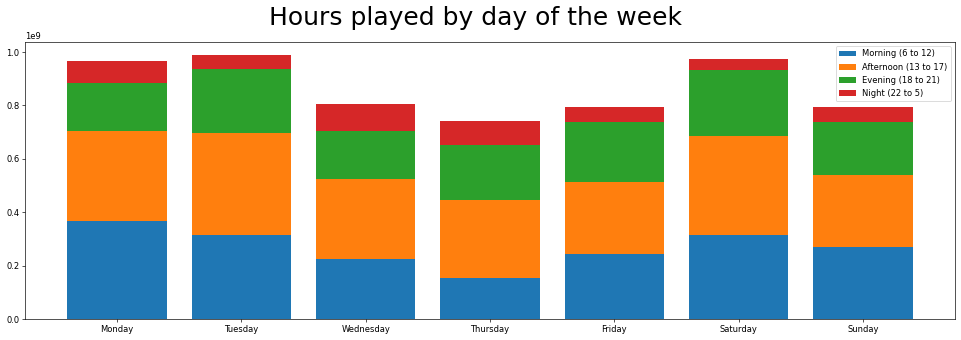

In [80]:
df_platform['Time'] = df_platform['Time of Day'].astype(int)
df_platform['Part'] = pd.cut(df_platform['Time'],
                                bins=[-1, 5, 12, 17, 21, 23],
                                labels=['Night', 'Morning', 'Afternoon',
                                        'Evening', 'Night'],
                                ordered=False)
day_of_week = df_platform.groupby(['Part', 'Weekday'])\
                        .agg({'ms_played': np.sum})

day_of_the_week = {'morning': day_of_week.loc['Morning'],
            'afternoon': day_of_week.loc['Afternoon'],
            'evening': day_of_week.loc['Evening'],
            'night': day_of_week.loc['Night']}

plt.figure(figsize=(20, 6), dpi=60)
days_labels = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Plot morning times
plt.bar(day_of_the_week['morning'].index, day_of_the_week['morning']['ms_played'], label='Morning (6 to 12)')
# Plot afternoon times
plt.bar(day_of_the_week['afternoon'].index,
        day_of_the_week['afternoon']['ms_played'],
        bottom=day_of_the_week['morning']['ms_played'],
        label='Afternoon (13 to 17)')
# Plot evening times
plt.bar(day_of_the_week['evening'].index,
        day_of_the_week['evening']['ms_played'],
        bottom=day_of_the_week['morning']['ms_played']+day_of_the_week['afternoon']['ms_played'],
        label='Evening (18 to 21)')
# Plot night times
plt.bar(day_of_the_week['night'].index, day_of_the_week['night']['ms_played'],
        bottom=day_of_the_week['morning']['ms_played'] +
        day_of_the_week['afternoon']['ms_played'] +
        day_of_the_week['evening']['ms_played'],
        label='Night (22 to 5)')
plt.xticks(range(7), days_labels)
plt.suptitle('Hours played by day of the week', fontsize=30)
plt.legend()

In [136]:
############################################################
#API
############################################################

CLIENT_ID = '****'
CLIENT_SECRET = '****'
client_credentials_manager = SpotifyClientCredentials(client_id=CLIENT_ID, client_secret=CLIENT_SECRET)
sp = spotipy.Spotify(client_credentials_manager=client_credentials_manager)
df_extended_features=df_extended.copy()

In [33]:
# REQUEST AUDIO FEATURES
audio_features = []

for track in df_extended_features.spotify_track_uri:
    if track is not None:
        af = sp.audio_features(track[14:])
        audio_features.append(af)
        
tf_df = pd.DataFrame(columns = ['danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'type', 'id', 'uri', 'track_href', 'analysis_url', 'duration_ms', 'time_signature'])
for item in audio_features:
  for feat in item:
    tf_df = tf_df.append(feat, ignore_index=True)
tf_df.head()
cols_to_drop2 = ['liveness', 'speechiness', 'duration_ms', 'time_signature', 'type', 'uri','track_href','analysis_url']
tf_df = tf_df.drop(columns=cols_to_drop2)

# Save to json file
out = tf_df.to_json(orient='index')
with open('df_audio_features.json', 'a') as fp:
    json.dump(out, fp)
    
tf_df

KeyboardInterrupt: 

In [137]:
# generate access token

# authentication URL
AUTH_URL = 'https://accounts.spotify.com/api/token'

# POST
auth_response = requests.post(AUTH_URL, {
    'grant_type': 'client_credentials',
    'client_id': CLIENT_ID,
    'client_secret': CLIENT_SECRET,
})

# convert the response to JSON
auth_response_data = auth_response.json()

# save the access token
access_token = auth_response_data['access_token']

# used for authenticating all API calls
headers = {'Authorization': 'Bearer {token}'.format(token=access_token)}

# base URL of all Spotify API endpoints
BASE_URL = 'https://api.spotify.com/v1/'

    
def request_tracks(tracks):
    r = requests.get(BASE_URL + 'tracks?market=DE&ids='+tracks, headers=headers)
    if(r.status_code == 200):
        return r.json()
    else:
        print("The server responded with an error to the request: "+str(r.status_code))
        return None
    
def request_artists(artists):
    r = requests.get(BASE_URL + 'artists?ids='+artists, headers=headers)
    if(r.status_code == 200):
        return r.json()
    else:
        print("The server responded with an error to the request: "+str(r.status_code))
        return None

In [204]:
# POPULARITY and ARTISTS
tracks = {}
        
# Split DataFrame into chunks
n = 50
index = 0
df_extended_features_chunk = [df_extended_features[i:i+n] for i in range(0,len(df_extended_features),n)]

for chunk in range(0, len(df_extended_features_chunk)):

    # All uris as list, where tracks are not none
    uris = df_extended_features_chunk[chunk].spotify_track_uri.values.tolist()
    uris = list(filter(lambda item: item is not None, uris))
    uris = [i[14:] for i in uris]

    # Request genres info for the uris
    response = request_tracks(','.join(uris))

    if(response == None):
        break

    for track in response['tracks']:
        track_id = track['uri'] + str(index)
        index = index + 1
        tracks[track_id] = {"uri":"", "popularity":[], 'artist_uri': ""}
        tracks[track_id]['popularity'] = track['popularity']
        tracks[track_id]['uri'] = track['uri']

        if len(track['artists']) > 0:
            tracks[track_id]['artist_uri'] = track['artists'][0]['uri'].split(':')[2]
            
                
with open('df_tracks.json', 'a') as fp:
    print(json.dumps(tracks), file=fp)

In [206]:
# REQUEST GENRES
genres = {}

with open('df_tracks.json', 'r') as datafile:
    data = json.load(datafile)
    df_tracks = pd.DataFrame(data)
    df_tracks = df_tracks.T
        
# Split DataFrame into chunks
n = 50
index = 0
df_tracks_chunk = [df_tracks[i:i+n] for i in range(0,len(df_tracks),n)]

for chunk in range(0, len(df_tracks_chunk)):

    # All uris as list, where tracks are not none
    uris = df_tracks_chunk[chunk].artist_uri.values.tolist()
    uris = list(filter(lambda item: item is not None, uris))
    uris = [i for i in uris]

    # Request genres info for the uris
    response = request_artists(','.join(uris))

    if(response == None):
        print("Error")
        break

    for artist in response['artists']:
        artist_id = artist['uri'] + str(index)
        index = index + 1
        
        genres[artist_id] = {"uri":"", "popularity":[], "genres":[]}
        genres[artist_id]['popularity'] = artist['popularity']
        genres[artist_id]['uri'] = artist['uri']

        if len(artist['genres']) > 0:
            genres[artist_id]['genres'] = artist['genres']

                
with open('df_artists.json', 'a') as fp:
    print(json.dumps(genres), file=fp)

In [37]:
# Extract genres
with open('df_artists.json', 'r') as datafile:
    data = json.load(datafile)
    df_artists = pd.DataFrame(data)
    df_artists = df_artists.T
    
df_artists.reset_index(inplace=True, drop=True)

df_genres = df_artists.explode("genres")
genres = df_genres["genres"].values.tolist()
genres = [x for x in genres if not pd.isnull(x)]

df_genres = df_genres[['genres', 'uri']]\
    .groupby('genres')\
    .count()\
    .sort_values('uri', ascending=False)\
    .reset_index()
df_genres.columns = ['Genre', 'Count']


df_genres.to_json("df_genre.json", orient="records")
df_genres

,Genre,Count
0,spanish pop,5114
1,pop,3236
2,latin pop,2803
3,cantautor,2638
4,latin talent show,1852
5,latin rock,1828
6,spanish indie pop,1811
7,rock,1573
8,rock en espanol,1520
9,latin viral pop,1512


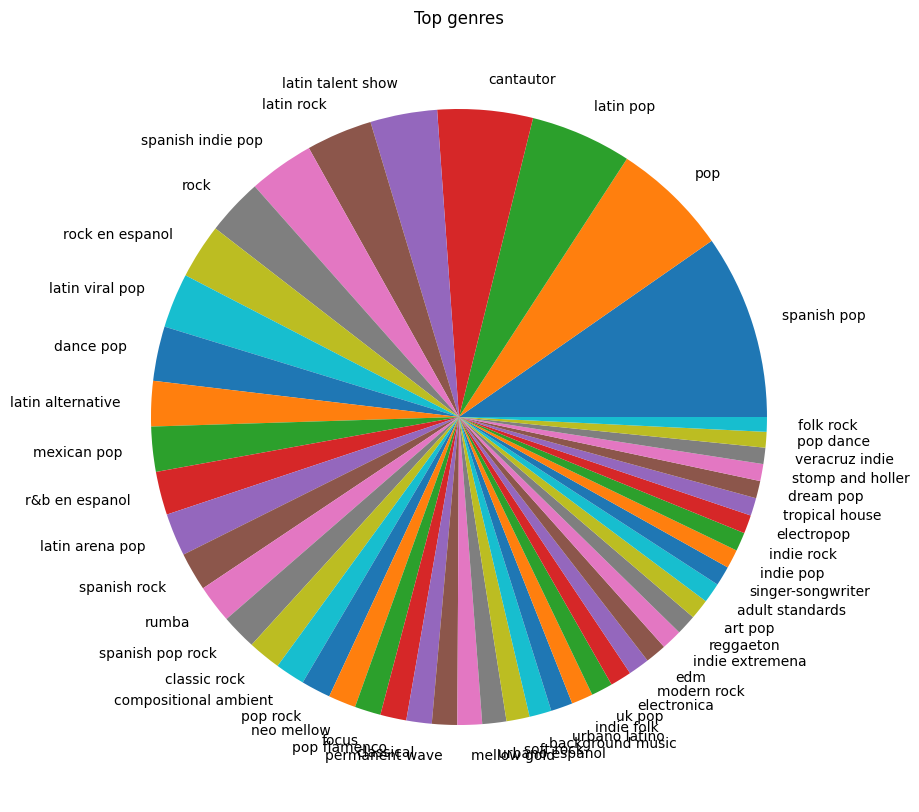

In [47]:
fig = plt.figure(figsize = (10, 10))
ax = fig.subplots()
counts = pd.Series(genres).value_counts()
counts[:50].plot(ax=ax, kind = "pie")
ax.set_ylabel("")
ax.set_title("Top genres")
plt.show()

In [39]:
df_genres = df_genres.sort_values(by=['Count'], ascending=False).head(20)
fig = px.bar(df_time, x=df_genres['Genre'].astype(dtype=str), 
                                y=df_genres['Count'])
fig.update_layout({"title": 'Top genres',
                   "xaxis": {"title":"Top genres"},
                   "yaxis": {"title":"Frequency"}})
fig.show()


In [118]:
df_audio_features.head(300)


,danceability,energy,mode,acousticness,instrumentalness,valence
0,0.591,0.296,0,0.686,0.000277,0.151
1,0.408,0.499,1,0.44,0.000004,0.501
2,0.474,0.308,0,0.762,0.0,0.418
3,0.549,0.902,1,0.0025,0.000004,0.775
4,0.396,0.535,1,0.889,0.00678,0.435
5,0.591,0.648,0,0.272,0.000023,0.564
6,0.766,0.482,1,0.182,0.0,0.635
7,0.82,0.41,0,0.785,0.0,0.554
8,0.768,0.529,1,0.00657,0.0,0.653
9,0.717,0.182,1,0.923,0.000023,0.463


In [353]:
# Function to convert a CSV to JSON
# Takes the file paths as arguments
def make_json(csvFilePath, jsonFilePath):
     
    # create a dictionary
    data = {}
     
    # Open a csv reader called DictReader
    with open(csvFilePath, encoding='utf-8') as csvf:
        csvReader = csv.DictReader(csvf)
         
        # Convert each row into a dictionary
        # and add it to data
        for rows in csvReader:
             
            # Assuming a column named 'No' to
            # be the primary key
            key = rows['uri']
            data[key] = rows
 
    # Open a json writer, and use the json.dumps()
    # function to dump data
    with open(jsonFilePath, 'w', encoding='utf-8') as jsonf:
        jsonf.write(json.dumps(data, indent=4))
         
# Driver Code
 
# Decide the two file paths according to your
# computer system
csvFilePath = r'spotify_top_charts_22.csv'
jsonFilePath = r'spotify_top_charts_22.json'
 
# Call the make_json function
make_json(csvFilePath, jsonFilePath)

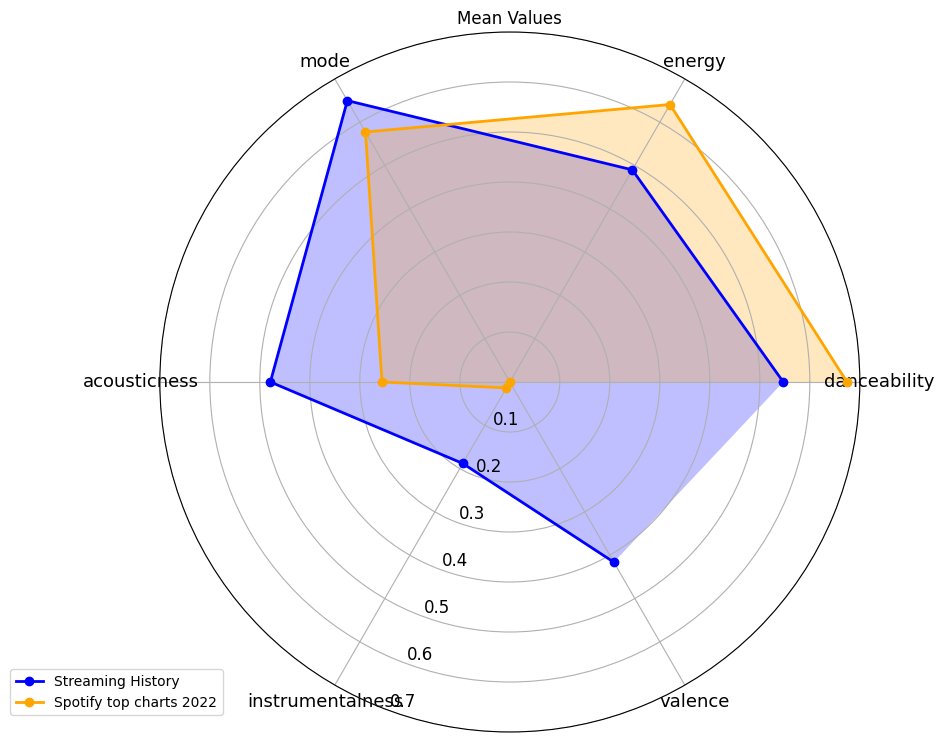

In [381]:
# Features
with open('df_audio_features.json', 'r') as datafile:
    data = json.load(datafile)
    df_audio_features = pd.DataFrame(data)
    df_audio_features = df_audio_features.drop('uri')
    df_audio_features = df_audio_features.drop('key')
    df_audio_features = df_audio_features.drop('tempo')
    df_audio_features = df_audio_features.drop('loudness')
    df_audio_features = df_audio_features.T
    
with open('spotify_top_charts_22.json', 'r') as datafile:
    data = json.load(datafile)
    spotify_top_charts_22 = pd.DataFrame(data)
    spotify_top_charts_22 = spotify_top_charts_22.drop('uri')
    spotify_top_charts_22 = spotify_top_charts_22.drop('key')
    spotify_top_charts_22 = spotify_top_charts_22.drop('tempo')
    spotify_top_charts_22 = spotify_top_charts_22.drop('loudness')
    spotify_top_charts_22 = spotify_top_charts_22.drop('duration_ms')
    spotify_top_charts_22 = spotify_top_charts_22.drop('time_signature')
    spotify_top_charts_22 = spotify_top_charts_22.drop('weeks_on_chart')
    spotify_top_charts_22 = spotify_top_charts_22.drop('liveness')
    spotify_top_charts_22 = spotify_top_charts_22.drop('peak_rank')
    spotify_top_charts_22 = spotify_top_charts_22.drop('artist_names')
    spotify_top_charts_22 = spotify_top_charts_22.drop('track_name')
    spotify_top_charts_22 = spotify_top_charts_22.drop('speechiness')
    spotify_top_charts_22 = spotify_top_charts_22.T
    spotify_top_charts_22["valence"] = 0.0
    spotify_top_charts_22["danceability"] = spotify_top_charts_22["danceability"].astype(float)
    spotify_top_charts_22["energy"] = spotify_top_charts_22["energy"].astype(float)
    spotify_top_charts_22["mode"] = spotify_top_charts_22["mode"].astype(float)
    spotify_top_charts_22["acousticness"] = spotify_top_charts_22["acousticness"].astype(float)
    spotify_top_charts_22["instrumentalness"] = spotify_top_charts_22["instrumentalness"].astype(float)
    
labels = list(df_audio_features)[:]
features = df_audio_features.mean().tolist()
features_all = spotify_top_charts_22.mean().tolist()

angles = np.linspace(0, 2*np.pi, len(labels), endpoint=False)
fig = plt.figure(figsize = (20,20))

ax = fig.add_subplot(221, polar=True)
ax.plot(angles, features, 'o-', linewidth=2, label = "Streaming History", color= 'blue')
ax.fill(angles, features, alpha=0.25, facecolor='blue')
ax.set_thetagrids(angles * 180/np.pi, labels , fontsize = 13)


ax.set_rlabel_position(250)
plt.yticks([0.1 , 0.2 , 0.3 , 0.4, 0.5,  0.6, 0.7, 0.8, 0.9, 1], ["0.1",'0.2', "0.3", "0.4", "0.5", "0.6", "0.7", "0.8", "0.9", "1.0"  ], size=12)
plt.ylim(0,0.7)

ax.plot(angles, features_all, 'o-', linewidth=2, label = "Spotify top charts 2022", color= 'orange')
ax.fill(angles, features_all, alpha=0.25, facecolor='orange')
ax.set_title('Mean Values')
ax.grid(True)

plt.legend(loc='best', bbox_to_anchor=(0.1, 0.1))

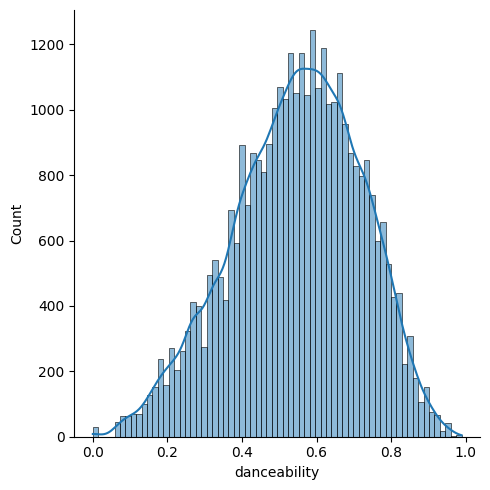

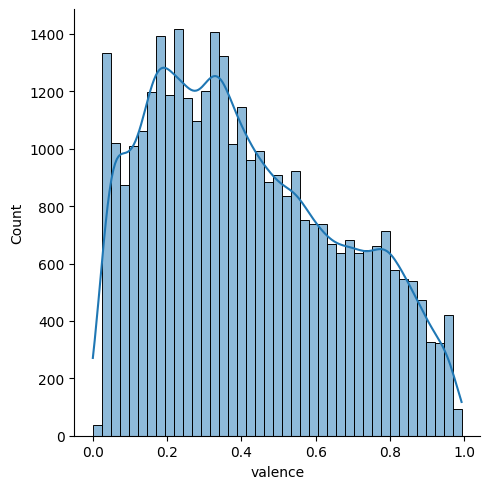

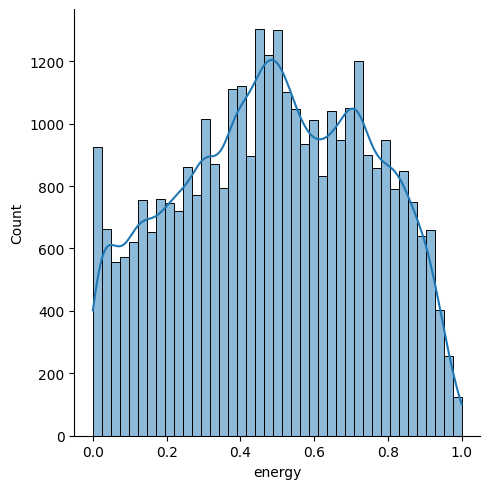

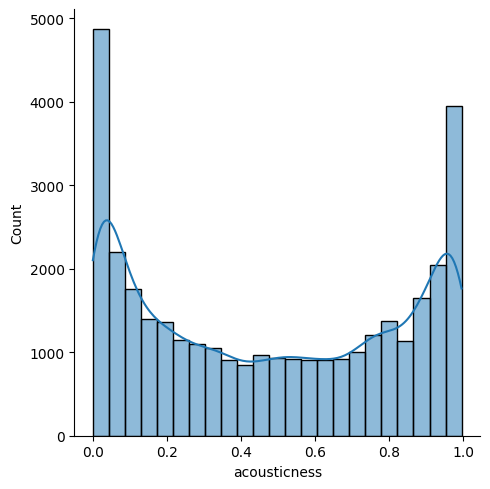

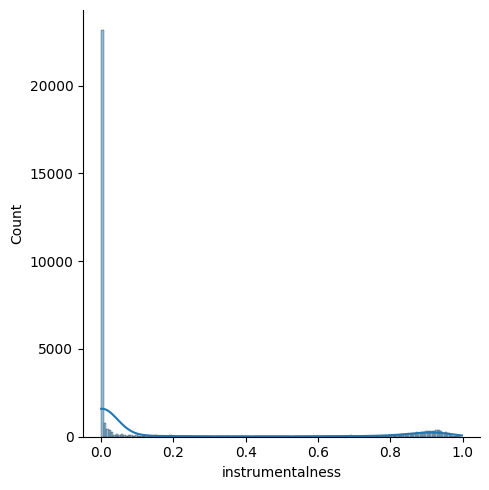

In [400]:
# Histograms of the features
features = ['danceability', 'valence', 'energy', 'acousticness', 'instrumentalness']

# plotting histogram for each feature
for col in features:
  seaborn.displot(df_audio_features, x=col, kde=True)
  plt.show()

<AxesSubplot: xlabel='key', ylabel='count'>

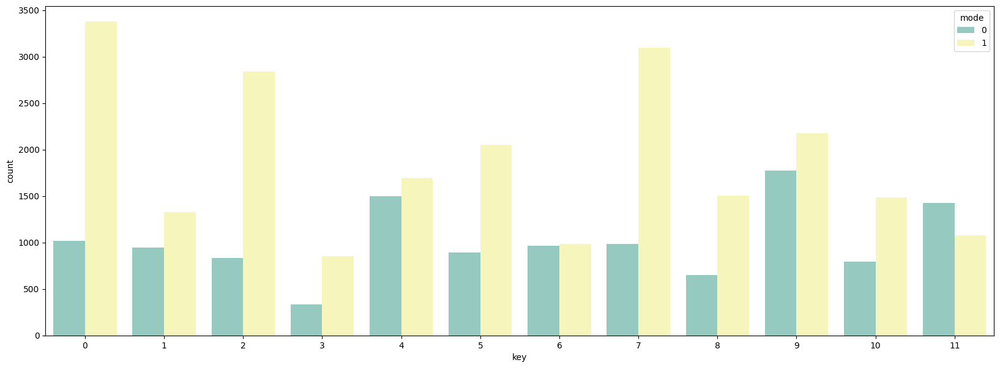

In [404]:
# Key and mode
with open('df_audio_features.json', 'r') as datafile:
    data = json.load(datafile)
    df_audio_features = pd.DataFrame(data)
    df_audio_features = df_audio_features.T

seaborn.countplot(data=df_audio_features, x='key', hue='mode', palette = 'Set3')

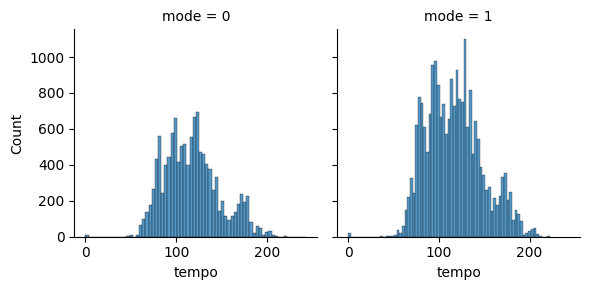

In [403]:
# Tempo
# Mode = 0 is minor, Mode = 1 is major
plt.rcParams['figure.figsize'] = (20,7)
g = seaborn.FacetGrid(df_audio_features, col='mode')
g.map(seaborn.histplot, "tempo")
plt.show()

<AxesSubplot: xlabel='danceability', ylabel='tempo'>

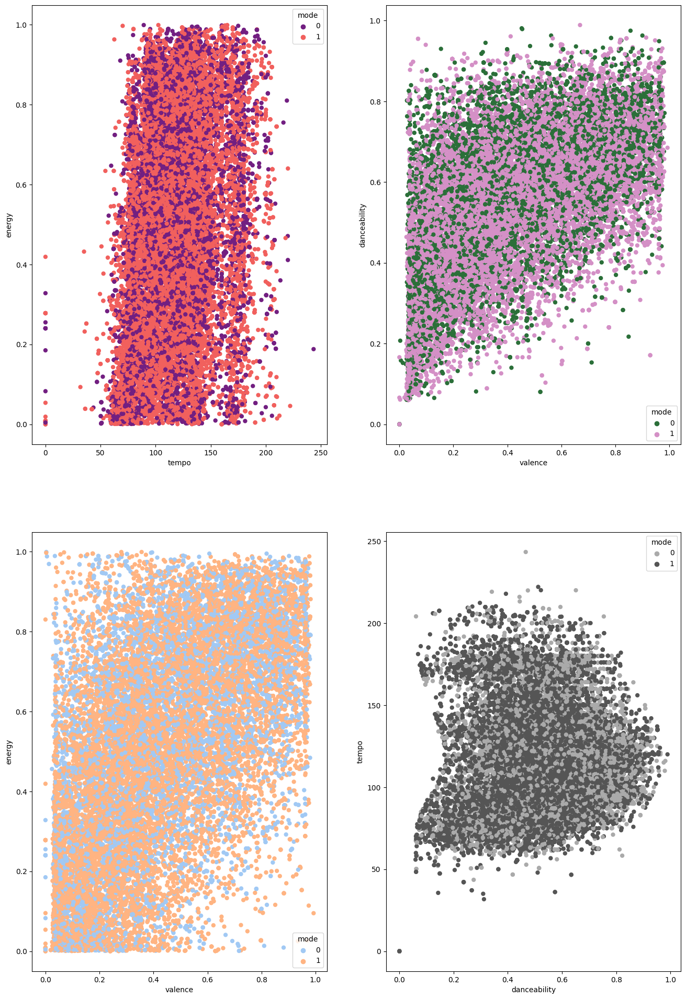

In [411]:
# Scatterplots to see the relationship between two variables
f, ax = plt.subplots(2,2, figsize=(16,24))

seaborn.scatterplot(x="tempo", y="energy",
                hue="mode", 
                palette="magma",
                sizes=(1, 8), linewidth=0,
                data=df_audio_features, ax=ax[0][0])

seaborn.scatterplot(x="valence", y="danceability",
                hue="mode", 
                palette="cubehelix",
                sizes=(1, 8), linewidth=0,
                data=df_audio_features, ax=ax[0][1])

seaborn.scatterplot(x="valence", y="energy",
                hue="mode", 
                palette="pastel",
                sizes=(1, 8), linewidth=0,
                data=df_audio_features, ax=ax[1][0])

seaborn.scatterplot(x="danceability", y="tempo",
                hue="mode", 
                palette="binary",
                sizes=(1, 8), linewidth=0,
                data=df_audio_features, ax=ax[1][1])

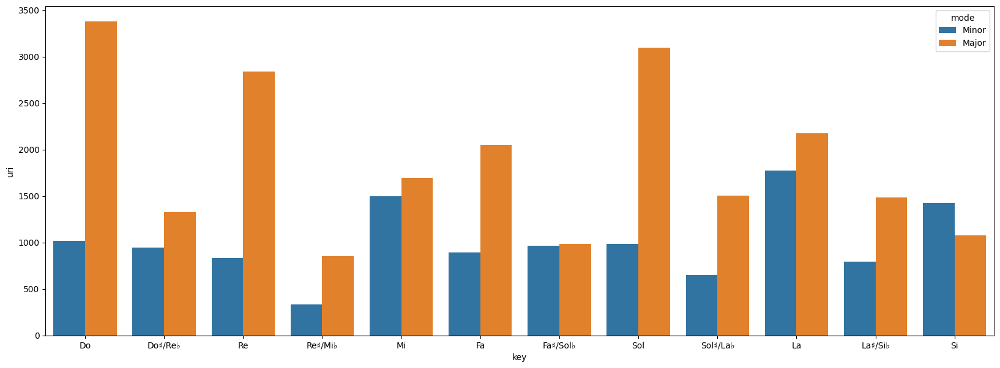

In [417]:
# Key
key_mode = df_audio_features.groupby(["key","mode"], as_index=False)["uri"].count()

# map the key in number to the real key represented in alphabet
key_dic = {0: "Do", 
           1: "Do♯/Re♭",
           2: "Re",
           3: "Re♯/Mi♭",
           4: "Mi",
           5: "Fa",
           6: "Fa♯/Sol♭",
           7: "Sol",
           8: "Sol♯/La♭",
           9: "La",
           10: "La♯/Si♭",
           11: "Si"}
mode_dic = {0: "Minor", 1: "Major"}
key_mode = key_mode.replace({"key": key_dic})
key_mode = key_mode.replace({"mode": mode_dic})

seaborn.barplot(data=key_mode, x='key', y='uri', hue='mode')
plt.show()

In [134]:
# Popularity of songs bar graph
with open('df_tracks.json', 'r') as datafile:
    data = json.load(datafile)
    df_popularity = pd.DataFrame(data)
    df_popularity = df_popularity.T

df_popularity = df_popularity[["popularity","uri"]]\
    .groupby('popularity')\
    .count()\
    .reset_index()
df_popularity.columns = ["popularity", "count"]
df_popularity.sort_values(by=['popularity'], ascending=False).head(20)

fig = px.bar(df_popularity, x=df_popularity['popularity'].astype(dtype=str), 
                                y=df_popularity['count'])
fig.update_layout({"title": 'Popularity of songs',
                   "xaxis": {"title":"Popularity of songs"},
                   "yaxis": {"title":"Frequency"}})
fig.show()

In [252]:
# Mean Popularity of listened tracks
df_popularity.popularity.mean()

44.611111111111114

In [135]:
# Popularity of artists bar graph
with open('df_artists.json', 'r') as datafile:
    data = json.load(datafile)
    df_artists = pd.DataFrame(data)
    df_artists = df_artists.T

df_artists = df_artists[["popularity","uri"]]\
    .groupby('popularity')\
    .count()\
    .reset_index()
df_artists.columns = ["popularity", "count"]
df_artists.sort_values(by=['popularity'], ascending=False)

fig = px.bar(df_artists, x=df_artists['popularity'].astype(dtype=str), 
                                y=df_artists['count'])
fig.update_layout({"title": 'Popularity of artists',
                   "xaxis": {"title":"Popularity of artists"},
                   "yaxis": {"title":"Frequency"}})
fig.show()

In [253]:
# Mean Popularity of listened artists
df_artists.popularity.mean()

59.131931387579186

In [306]:
with open('df_tracks.json', 'r') as datafile:
    data = json.load(datafile)
    df_tracks = pd.DataFrame(data)
    df_tracks = df_tracks.T
    
df_history = df_extended.dropna(subset=['spotify_track_uri'])

df_tracks['title'] = df_history["master_metadata_track_name"].values
df_tracks['artist'] = df_history["master_metadata_album_artist_name"].values
df_tracks['timestamp'] = df_history["ts"].values
df_tracks['ms_played'] = df_history["ms_played"].values

    
with open('df_artists.json', 'r') as datafile:
    data = json.load(datafile)
    df_artists = pd.DataFrame(data)
    df_artists = df_artists.T
    df_artists = df_artists.loc[df_artists.astype(str).drop_duplicates().index]
    
df_tracks = df_tracks.merge(df_artists[["artist_uri", "genres"]], on='artist_uri', how="left")
df_tracks.to_json("df_full_tracks.json", orient="records")

In [3]:
with open('df_full_tracks.json', 'r') as datafile:
    data = json.load(datafile)
    df_tracks = pd.DataFrame(data)
    
with open('df_audio_features.json', 'r') as datafile:
    data = json.load(datafile)
    df_audio_features = pd.DataFrame(data)
    df_audio_features = df_audio_features.drop('key')
    df_audio_features = df_audio_features.drop('tempo')
    df_audio_features = df_audio_features.drop('loudness')
    df_audio_features = df_audio_features.T

df_tracks = df_tracks.merge(df_audio_features[["uri", "danceability", "energy", "acousticness", "instrumentalness", "valence", "mode"]], on='uri', how="left")
df_tracks.to_json("df_full_tracks_audio_features.json", orient="records")    

In [4]:
# Scatter chart of audio features overtime
df_tracks_features = df_tracks.copy()
df_tracks_features['day'] = df_tracks_features['timestamp'].str[0:10]
df_tracks_features['date'] = [parse(date).date() for date in df_tracks_features['day']]
df_tracks_features['Month'] = pd.to_datetime(df_tracks_features['date']).dt.to_period('M')

df_tracks_features_danceability = df_tracks_features[['Month', 'danceability']]\
    .groupby('Month')\
    .mean()\
    .sort_values('Month', ascending=True)\
    .reset_index()
df_tracks_features_energy = df_tracks_features[['Month', 'energy']]\
    .groupby('Month')\
    .mean()\
    .sort_values('Month', ascending=True)\
    .reset_index()
df_tracks_features_acousticness = df_tracks_features[['Month', 'acousticness']]\
    .groupby('Month')\
    .mean()\
    .sort_values('Month', ascending=True)\
    .reset_index()
df_tracks_features_instrumentalness = df_tracks_features[['Month', 'instrumentalness']]\
    .groupby('Month')\
    .mean()\
    .sort_values('Month', ascending=True)\
    .reset_index()
df_tracks_features_valence = df_tracks_features[['Month', 'valence']]\
    .groupby('Month')\
    .mean()\
    .sort_values('Month', ascending=True)\
    .reset_index()
df_tracks_features_mode = df_tracks_features[['Month', 'mode']]\
    .groupby('Month')\
    .mean()\
    .sort_values('Month', ascending=True)\
    .reset_index()

plot = go.Figure()
plot.add_trace(go.Scatter(
    name = 'danceability',
    x = df_tracks_features_danceability['Month'].astype(dtype=str),
    y = df_tracks_features_danceability['danceability'], 
    stackgroup='one',mode='none'
   )
)
plot.add_trace(go.Scatter(
    name = 'energy',
    x = df_tracks_features_energy['Month'].astype(dtype=str),
    y = df_tracks_features_energy['energy'], 
    stackgroup='one',mode='none'
   )
)
plot.add_trace(go.Scatter(
    name = 'acousticness',
    x = df_tracks_features_acousticness['Month'].astype(dtype=str),
    y = df_tracks_features_acousticness['acousticness'], 
    stackgroup='one',mode='none'
   )
)
plot.add_trace(go.Scatter(
    name = 'instrumentalness',
    x = df_tracks_features_instrumentalness['Month'].astype(dtype=str),
    y = df_tracks_features_instrumentalness['instrumentalness'], 
    stackgroup='one',mode='none'
   )
)
plot.add_trace(go.Scatter(
    name = 'valence',
    x = df_tracks_features_valence['Month'].astype(dtype=str),
    y = df_tracks_features_valence['valence'], 
    stackgroup='one',mode='none'
   )
)
plot.add_trace(go.Scatter(
    name = 'mode',
    x = df_tracks_features_mode['Month'].astype(dtype=str),
    y = df_tracks_features_mode['mode'], 
    stackgroup='one',mode='none'
   )
)
plot.show()

In [307]:
# Popularity of listened tracks by time
df_tracks_popularity=df_tracks.copy()
df_tracks_popularity['Day']=df_tracks_popularity['timestamp'].str[0:10]

# Draw line chart by day
df_tracks_popularity = df_tracks_popularity[['Day', 'popularity']]\
    .groupby('Day')\
    .mean()\
    .sort_values('Day', ascending=True)\
    .reset_index()
fig = go.Figure(data=go.Scatter(x=df_tracks_popularity['Day'].astype(dtype=str), 
                                y=df_tracks_popularity['popularity'],
                                marker_color='indianred', text="Mean Popularity"))
fig.update_layout({"title": 'Mean Popularity of listened tracks over time',
                   "xaxis": {"title":"Day"},
                   "yaxis": {"title":"Popularity"}})
fig.update_traces(mode="lines", hovertemplate=None)
fig.update_layout(hovermode="x")
fig.show()


# Draw line chart by month
df_tracks_popularity['date'] = [parse(date).date() for date in df_tracks_popularity['Day']]
df_tracks_popularity['Month'] = pd.to_datetime(df_tracks_popularity['date']).dt.to_period('M')
df_tracks_popularity = df_tracks_popularity[['Month', 'popularity']]\
    .groupby('Month')\
    .mean()\
    .sort_values('Month', ascending=True)\
    .reset_index()

fig = go.Figure(data=go.Scatter(x=df_tracks_popularity['Month'].astype(dtype=str), 
                                y=df_tracks_popularity['popularity'],
                                marker_color='indianred', text="Mean Popularity"))
fig.update_layout({"title": 'Mean Popularity of listened tracks over time',
                   "xaxis": {"title":"Month"},
                   "yaxis": {"title":"Popularity"}})
fig.update_traces(mode="lines", hovertemplate=None)
fig.update_layout(hovermode="x")
fig.show()

In [6]:
# Scatter chart of top genres overtime
df_tracks_genres = df_tracks.copy().explode("genres")
df_tracks_genres['day'] = df_tracks_genres['timestamp'].str[0:10]

df_tracks_genres_rock = df_tracks_genres[df_tracks_genres['genres']=="rock"]
df_tracks_genres_pop = df_tracks_genres[df_tracks_genres['genres']=="pop"]
df_tracks_genres_techno = df_tracks_genres[df_tracks_genres['genres']=="techno"]
df_tracks_genres_indie = df_tracks_genres[df_tracks_genres['genres']=="indie"]

plot = go.Figure()
plot.add_trace(go.Scatter(
    name = 'Rock',
    x = df_tracks_genres_rock['day'],
    y = df_tracks_genres_rock['ms_played'], 
    stackgroup='one',mode='none'
   )
)
plot.add_trace(go.Scatter(
    name = 'Pop',
    x = df_tracks_genres_pop['day'],
    y = df_tracks_genres_pop['ms_played'], 
    stackgroup='one',mode='none'
   )
)
plot.add_trace(go.Scatter(
    name = 'Latin Pop',
    x = df_tracks_genres_techno['day'],
    y = df_tracks_genres_techno['ms_played'], 
    stackgroup='one',mode='none'
   )
)
plot.add_trace(go.Scatter(
    name = 'Cantautor',
    x = df_tracks_genres_indie['day'],
    y = df_tracks_genres_indie['ms_played'], 
    stackgroup='one',mode='none'
   )
)
plot.show()

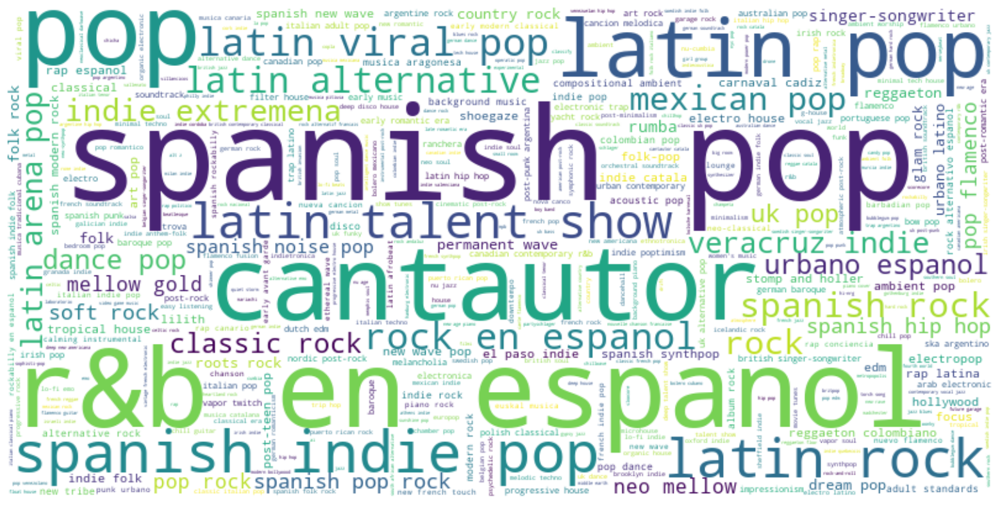

In [15]:
# Wordcloud of genres
df_genres = df_tracks_genres.explode("genres")
genres = df_genres["genres"].values.tolist()
genres = [x for x in genres if not pd.isnull(x)]

df_genres = df_genres[['genres', 'uri']]\
    .groupby('genres')\
    .count()\
    .sort_values('uri', ascending=False)\
    .reset_index()
df_genres.columns = ['Genre', 'Count']

genres_freq = dict(zip(df_genres['Genre'].tolist(), df_genres['Count'].tolist()))

# plot wordcloud
wc = WordCloud(background_color='white',width=800, height=400, max_words=500).generate_from_frequencies(genres_freq)
plt.figure(figsize=(20, 10))
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.show()